<a href="https://colab.research.google.com/github/aashrithresearch/pytorch_pathology/blob/main/epistroma/visualizations_epi.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
dataname = 'epistroma' #helps w handling files
gpuid = 0
patch_size = 256
batch_size = 1
edge_weight = 1

In [ ]:
!pip install tensorboardX -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 6.6 MB/s eta 0:00:00


In [ ]:
import random, sys
import cv2
import glob
import math
import matplotlib.pyplot as plt
import numpy as np
import os
import scipy.ndimage
import skimage
import time
import tables
from skimage import io, morphology
from sklearn.metrics import confusion_matrix
from tensorboardX import SummaryWriter
import torch
import torch.nn.functional as F
from torch import nn
from torch.utils.data import DataLoader
from torchvision import transforms
import PIL

In [ ]:
import torch
from torch import nn
import torch.nn.functional as F


class UNet(nn.Module):
    def __init__(self, in_channels=1, n_classes=2, depth=5, wf=6, padding=False,
                 batch_norm=False, up_mode='upconv'):
        super(UNet, self).__init__()
        assert up_mode in ('upconv', 'upsample')
        self.padding = padding
        self.depth = depth
        prev_channels = in_channels
        self.down_path = nn.ModuleList()
        for i in range(depth):
            self.down_path.append(UNetConvBlock(prev_channels, 2**(wf+i),
                                                padding, batch_norm))
            prev_channels = 2**(wf+i)

        self.up_path = nn.ModuleList()
        for i in reversed(range(depth - 1)):
            self.up_path.append(UNetUpBlock(prev_channels, 2**(wf+i), up_mode,
                                            padding, batch_norm))
            prev_channels = 2**(wf+i)

        self.last = nn.Conv2d(prev_channels, n_classes, kernel_size=1)

    def forward(self, x):
        blocks = []
        for i, down in enumerate(self.down_path):
            x = down(x)
            if i != len(self.down_path)-1:
                blocks.append(x)
                x = F.avg_pool2d(x, 2)

        for i, up in enumerate(self.up_path):
            x = up(x, blocks[-i-1])

        return self.last(x)


class UNetConvBlock(nn.Module):
    def __init__(self, in_size, out_size, padding, batch_norm):
        super(UNetConvBlock, self).__init__()
        block = []

        block.append(nn.Conv2d(in_size, out_size, kernel_size=3,
                               padding=int(padding)))
        block.append(nn.ReLU())
        if batch_norm:
            block.append(nn.BatchNorm2d(out_size))

        block.append(nn.Conv2d(out_size, out_size, kernel_size=3,
                               padding=int(padding)))
        block.append(nn.ReLU())
        if batch_norm:
            block.append(nn.BatchNorm2d(out_size))

        self.block = nn.Sequential(*block)

    def forward(self, x):
        out = self.block(x)
        return out


class UNetUpBlock(nn.Module):
    def __init__(self, in_size, out_size, up_mode, padding, batch_norm):
        super(UNetUpBlock, self).__init__()
        if up_mode == 'upconv':
            self.up = nn.ConvTranspose2d(in_size, out_size, kernel_size=2,
                                         stride=2)
        elif up_mode == 'upsample':
            self.up = nn.Sequential(nn.Upsample(mode='bilinear', scale_factor=2),
                                    nn.Conv2d(in_size, out_size, kernel_size=1))

        self.conv_block = UNetConvBlock(in_size, out_size, padding, batch_norm)

    def center_crop(self, layer, target_size):
        _, _, layer_height, layer_width = layer.size()
        diff_y = (layer_height - target_size[0]) // 2
        diff_x = (layer_width - target_size[1]) // 2
        return layer[:, :, diff_y:(diff_y + target_size[0]), diff_x:(diff_x + target_size[1])]

    def forward(self, x, bridge):
        up = self.up(x)
        crop1 = self.center_crop(bridge, up.shape[2:])
        out = torch.cat([up, crop1], 1)
        out = self.conv_block(out)

        return out

In [ ]:
print(torch.cuda.get_device_properties(gpuid))
torch.cuda.set_device(gpuid)
device = torch.device(f'cuda:{gpuid}' if torch.cuda.is_available() else 'cpu')

_CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15095MB, multi_processor_count=40, uuid=860485d7-f8ae-72ec-4259-b131e7931a77, L2_cache_size=4MB)


In [ ]:
checkpoint = torch.load(f"/content/drive/MyDrive/epi/{dataname}_unet_best_model.pth", weights_only=False)

In [ ]:
model = UNet(n_classes=checkpoint["n_classes"], in_channels=checkpoint["in_channels"], padding=checkpoint["padding"],depth=checkpoint["depth"],
             wf=checkpoint["wf"], up_mode=checkpoint["up_mode"], batch_norm=checkpoint["batch_norm"]).to(device)
print(f"total params: \t{sum([np.prod(p.size()) for p in model.parameters()])}")
model.load_state_dict(checkpoint["model_dict"])

total params: 	122466


<All keys matched successfully>

In [ ]:
#creating dataset class to use later
class Dataset(object):
    def __init__(self, fname ,img_transform=None, mask_transform = None, edge_weight= False):
        self.fname=fname
        self.edge_weight = edge_weight

        self.img_transform=img_transform
        self.mask_transform = mask_transform

        self.tables=tables.open_file(self.fname)
        self.numpixels=self.tables.root.numpixels[:]
        self.nitems=self.tables.root.img.shape[0]
        self.tables.close()

        self.img = None
        self.mask = None
    def __getitem__(self, index):
        if(self.img is None):
            self.tables=tables.open_file(self.fname)
            self.img=self.tables.root.img
            self.mask=self.tables.root.mask

        img = self.img[index,:,:,:]
        mask = self.mask[index,:,:]

        if(self.edge_weight):
            weight = scipy.ndimage.morphology.binary_dilation(mask==1, iterations =2) & ~mask
        else:
            weight = np.ones(mask.shape,dtype=mask.dtype)

        mask = mask[:,:,None].repeat(3,axis=2)
        weight = weight[:,:,None].repeat(3,axis=2)

        img_new = img
        mask_new = mask
        weight_new = weight

        seed = random.randrange(sys.maxsize)
        if self.img_transform is not None:
            random.seed(seed)
            img_new = self.img_transform(img)

        if self.mask_transform is not None:
            random.seed(seed)
            mask_new = self.mask_transform(mask)
            mask_new = np.asarray(mask_new)[:,:,0].squeeze()

            random.seed(seed)
            weight_new = self.mask_transform(weight)
            weight_new = np.asarray(weight_new)[:,:,0].squeeze()

        return img_new, mask_new, weight_new
    def __len__(self):
        return self.nitems

In [ ]:
img_transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.RandomCrop(size=(patch_size,patch_size),pad_if_needed=True), #these need to be in a reproducible order, first affine transforms and then color
    transforms.ToTensor()
    ])


mask_transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.RandomCrop(size=(patch_size,patch_size),pad_if_needed=True), #these need to be in a reproducible order, first affine transforms and then color
    ])

phases=["val"]
dataset={}
dataLoader={}
for phase in phases:

    dataset[phase]=Dataset(f"/content/drive/MyDrive/epi/{dataname}_{phase}.pytable", img_transform=img_transform , mask_transform = mask_transform ,edge_weight=edge_weight)
    dataLoader[phase]=DataLoader(dataset[phase], batch_size=batch_size,
                                shuffle=True, num_workers=0, pin_memory=True)


<ipython-input-11-24870d06edea>:27: DeprecationWarning: Please import `binary_dilation` from the `scipy.ndimage` namespace; the `scipy.ndimage.morphology` namespace is deprecated and will be removed in SciPy 2.0.0.
  weight = scipy.ndimage.morphology.binary_dilation(mask==1, iterations =2) & ~mask
/usr/local/lib/python3.11/dist-packages/torch/utils/data/_utils/collate.py:285: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at /pytorch/torch/csrc/utils/tensor_numpy.cpp:203.)
  return collate([torch.as_tensor(b) for b in batch], collate_fn_map=collate_fn_map)


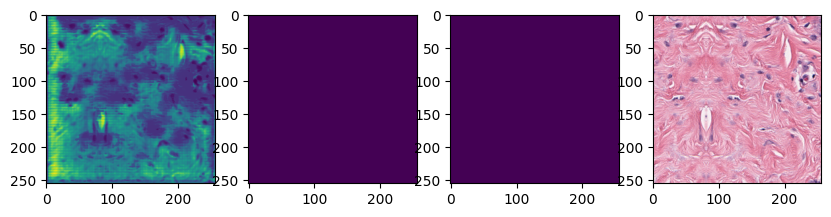

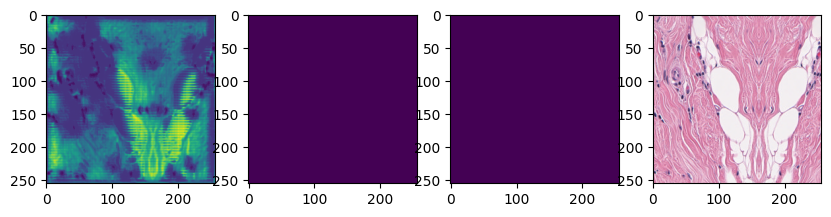

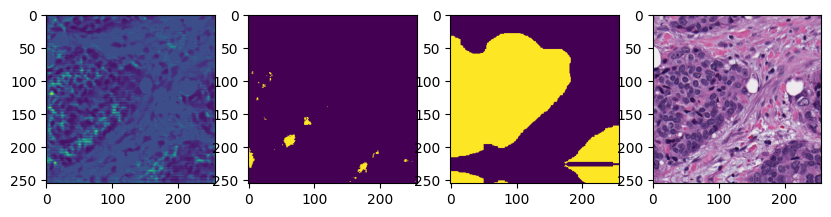

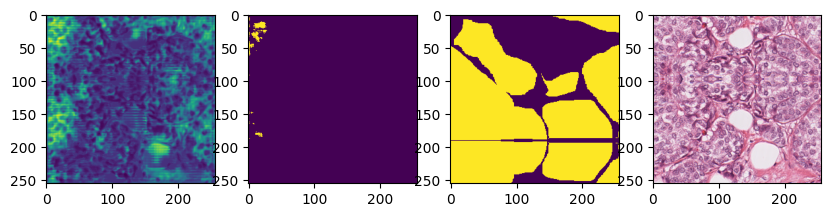

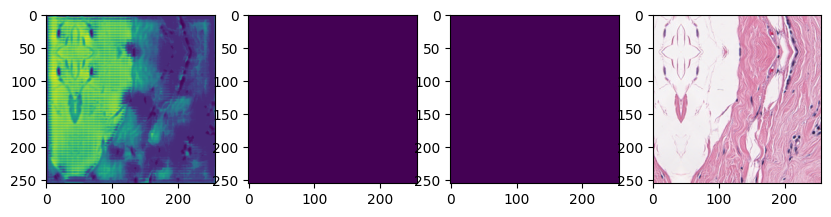

...

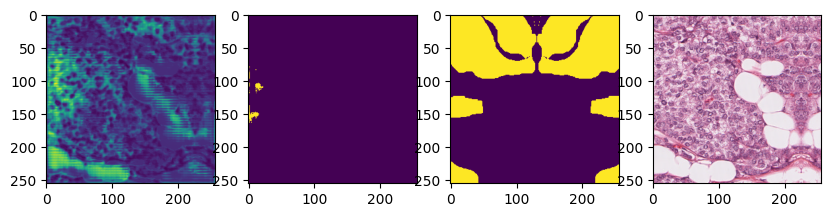

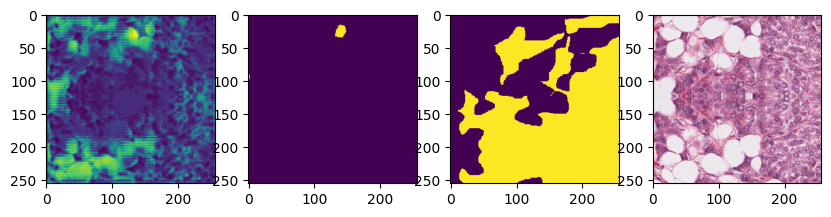

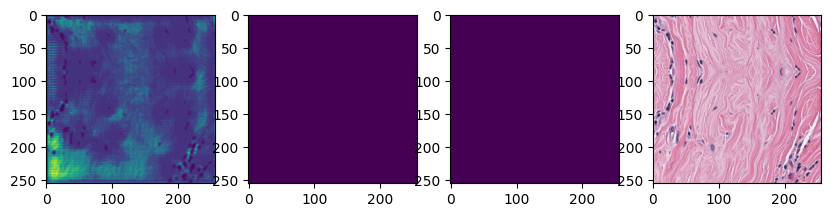

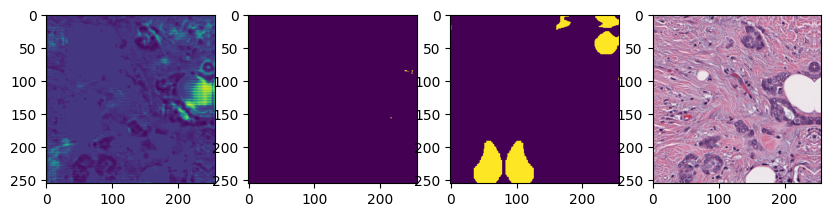

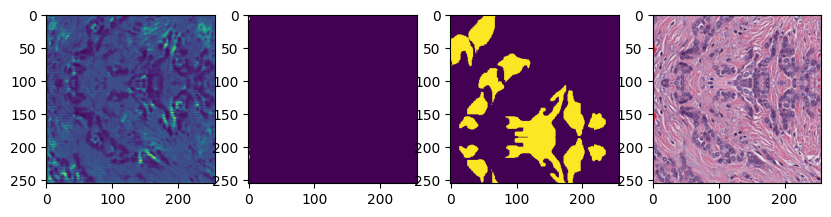

In [ ]:
%matplotlib inline

model.eval()
for ii , (X, y, y_weight) in enumerate(dataLoader["val"]):
    X = X.to(device)
    y = y.type('torch.LongTensor').to(device)

    output = model(X)

    output=output.detach().squeeze().cpu().numpy()
    output=np.moveaxis(output,0,-1)

    fig, ax = plt.subplots(1,4, figsize=(10,4))

    ax[0].imshow(output[:,:,1])
    ax[1].imshow(np.argmax(output,axis=2))
    ax[2].imshow(y.detach().squeeze().cpu().numpy())
    ax[3].imshow(np.moveaxis(X.detach().squeeze().cpu().numpy(),0,-1))
    plt.show()